## Assignment 5

This assignment is designed to help you understand, implement, and get hold of two important models in Multi-Modal Learning: CLIP and BLIP.

Before starting to code, read the instructions and comments carefully. Make sure you understand the requirements and the expected output.

There are two parts of this assignment.
- Content based image retrieval (CBIR) based on CLIP
- Visual Question Answering (VQA) based on BLIP

## Part 1: Content Based Image Retrieval (CBIR)

Ever found yourself looking for a specific image in a load of photos on your phone?
Imagine you have a system that can retrieve images based on their content. In this assignment, you will implement exactly that.

### Task
1. I have provided a list of images in form of unsplash links. Feel free to explore and add more images.
2. You will have to implement CBIR system that will retrive images based on the query you provide.
3. You have to use CLIP model to extract image and text embeddings. Since CLIP projects both image and text into the same embedding space, similar images and their corresponding text descriptions will be close to each other in the embedding space.
4. You have to use a pretrained CLIP model from HuggingFace. (Because it is not feasible to train CLIP from scratch)
5. You have to use [OpenAI's CLIP](https://huggingface.co/openai/clip-vit-base-patch32) model from HuggingFace. Refer to the page itself and anyother resources you find useful, on how to use it.
6. You will have to take an input query from user, and display the best image matching the query. (You can use cosine similarity to find similarity between the query and the images, then display the image with highest similarity score)

##### Load all the libraries

In [1]:
from transformers import CLIPProcessor, CLIPModel
import torch
from PIL import Image
import requests
from io import BytesIO
import torch.nn.functional as F
from IPython.display import display

IMAGE_URLS = [
    "https://images.unsplash.com/photo-1750126833705-ba98013f16f3",
    "https://images.unsplash.com/photo-1749627995669-4d4dda3a9c1d",
    "https://images.unsplash.com/photo-1744294724362-3f5c404c771a",
    "https://images.unsplash.com/photo-1750075750236-3f8924fc0e35"
]
# Feel free to edit the above list with your own image URLs

##### Load the CLIP model

In [2]:
model = CLIPModel.from_pretrained('openai/clip-vit-base-patch32')
processor = CLIPProcessor.from_pretrained('openai/clip-vit-base-patch32')

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


##### Loop through images, convert then to tensors, and store them in a list

In [3]:
images = []

for url in IMAGE_URLS:
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert('RGB')
    images.append(img)

##### Get the embeddings for the images and store them in a list
Use the CLIP model linked above, the page also provides details on how to use it. If you have any issues with it, feel free to use anyother resources you find useful.

In [4]:
image_embeddings = []

for img in images:
    inputs = processor(images=img, return_tensors='pt', padding=True)
    with torch.no_grad():
        embedding = model.get_image_features(**inputs)
    image_embeddings.append(embedding)

##### Get the query from user

In [5]:
query = input('Enter which image are you looking for: ')

Enter which image are you looking for:  boats floating in a river with foggy mountains at a distance


##### Get the embeddings for the user query

In [6]:
inputs = processor(text=query, return_tensors='pt', padding=True)
with torch.no_grad():
    query_embedding = model.get_text_features(**inputs)

##### Find the similarity between the query and all the images

In [7]:
similarities = []

for img_emb in image_embeddings:
    sim = F.cosine_similarity(query_embedding, img_emb)
    similarities.append(sim.item())

##### Display the image with highest similarity score

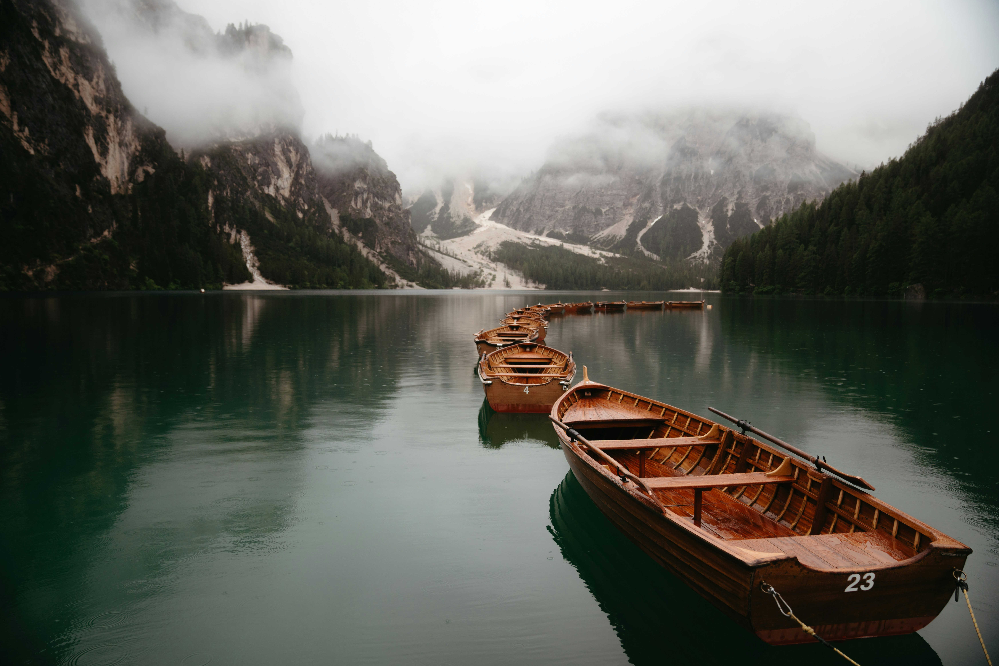

In [8]:
best_match_idx = similarities.index(max(similarities))
display(images[best_match_idx])

Congrats! You have implemented a simple Content Based Image Retrieval (CBIR) system using CLIP model.

Moving on to the next part of the assignment.

## Part 2: Visual Question Answering (VQA)

This part is based on Visual Question Answering (VQA), where you will be given an image and a question about that image, and you will need to provide an answer.

You are provided with a dataset of 10 images, and a json file containing questions and answers for those images.

### Format of JSON file
```json
[
    "what is the blue shape?",
    "rectangle",
    0
]
```
This means that the question is "what is the blue shape?", the answer is "rectangle", and the image index is 0.
Images are named from 0 to 9, so the image for index 0 is `0.png`.

### Task
1. Load the JSON file and parse the questions and answers.
2. Just for understanding, print a few questions and their corresponding answers, also display the corresponding images. (You may do it for 1 or 2 questions)
3. Implement a function that takes an image and a question, and returns the answer.
4. Run the function on all questions and store the answers in a file. (You can store it in a new JSON or CSV file) (May use pandas for this)
5. Now since you have the answers, you can also evaluate your model. For this, you can compare your answers with the ground truth answers provided in the JSON file. (refer to note below)

Note: But it is not that easy to compare directly, as the answers may not match exactly due to variations in phrasing ("2" and "two", "blue" and "The color is blue". Phrases like this don't match, but are correct). So you should check your answers manually and see if they are correct or not. Do it for first 30 answers, and calculate the accuracy.
There are certain ways to automate this, but they will make this assignment too complicated, so we will not do that here.

### Additional Points
- Refer to BLIP model that was taught in last class. It can be used to answer questions based on images.
- You will have to use pre-trained BLIP model for this task. (Because training it from scratch is not feasible in this assignment)
- You have to use [Salesforce BLIP model](https://huggingface.co/Salesforce/blip-vqa-base) for this task. Refer to the Usage section of page for details on how to use it. If you feel stuck, you can refer to blogs available online, or use AI tools to get yourself familiar with the model.

1. Load libraries, and the JSON file.

In [9]:
import numpy as np
import pandas as pd
import json
from transformers import BlipProcessor, BlipForQuestionAnswering

with open('filtered_questions.json') as f:
    qa_data = json.load(f)

2. Display a few questions and answers along with images.

Question: is there a blue shape?
Answer: no


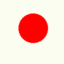

_________________________________________________________
Question: is there not a triangle in the image?
Answer: yes


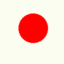

_________________________________________________________
Question: is there not a gray shape?
Answer: yes


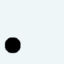

_________________________________________________________
Question: what shape is present?
Answer: rectangle


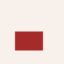

_________________________________________________________
Question: is there not a blue shape in the image?
Answer: no


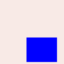

_________________________________________________________


In [12]:
for i in np.random.choice(range(len(qa_data)), 5, replace = False):
    question, answer, image_index = qa_data[i]
    print(f'Question: {question}')
    print(f'Answer: {answer}')
    image_path = f'images_updated/{image_index}.png'
    image = Image.open(image_path).convert('RGB')
    display(image)
    print('_________________________________________________________')

3. Implement the function to answer questions based on images.

In [13]:
processor = BlipProcessor.from_pretrained('Salesforce/blip-vqa-base')
model = BlipForQuestionAnswering.from_pretrained('Salesforce/blip-vqa-base')

def vqa(question, image):
    inputs = processor(image, question, return_tensors='pt')
    with torch.no_grad():
        out = model.generate(**inputs)
    answer = processor.decode(out[0], skip_special_tokens=True)
    return answer

4. Run the function on all questions and store the answers in a file.

In [14]:
results = []

for qa in qa_data:
    question, ground_truth, image_index = qa
    image_path = f'images_updated/{image_index}.png'
    image = Image.open(image_path).convert('RGB')
    answer = vqa(question, image)
    
    results.append([question, answer, ground_truth, image_index])

5. Evaluate the model by comparing answers with ground truth.
Do the comparison manually for the first 30 answers and print the accuracy.

In [15]:
def accuracy(a):
    correct = 0
    for idx in range(a):
        predicted = results[idx][1].lower().strip()
        actual = results[idx][2].lower().strip()
        if predicted == actual:
            correct += 1
    return (correct / a * 100)
accuracy_for_all = accuracy(len(results))  
accuracy_for_30 = accuracy(30)

print(f'Accuracy for first 30 observations: {accuracy_for_30:.2f}%')
print(f'Accuracy for all observations: {accuracy_for_all:.2f}%')

Accuracy for first 30 observations: 73.33%
Accuracy for all observations: 81.37%


Bonus: This images were too simple. But guess what? Salesforce has pretrained it's model on wide variety of images, so you can use it on any image of your choice.

Try to load any real world image of any natural scene, or anything you like, and ask questions about it. You will be surprised by the results.

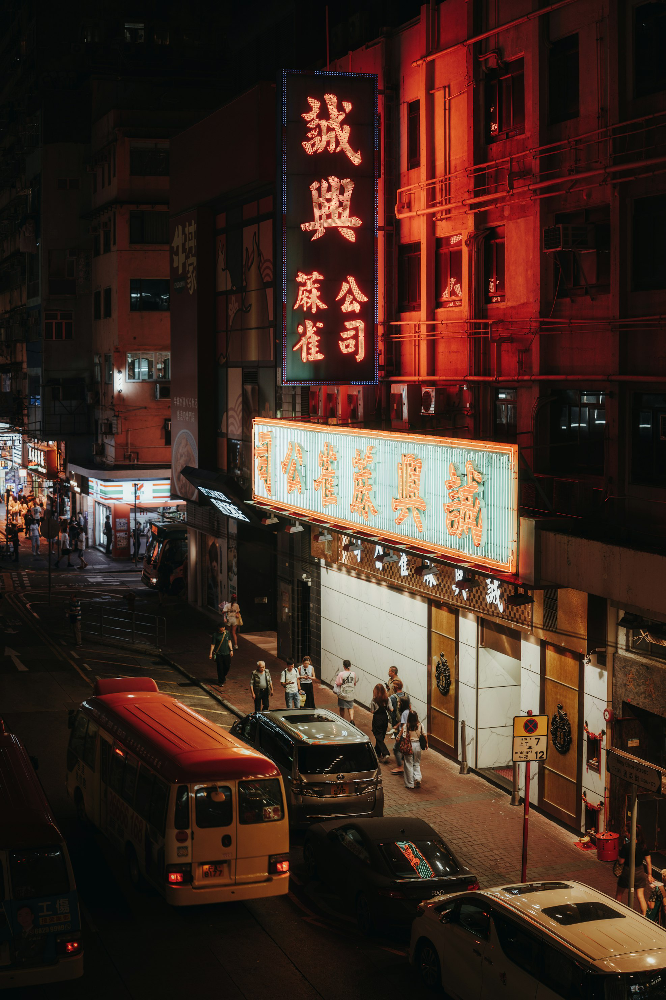

In [16]:
image_url = 'https://images.unsplash.com/photo-1747134392756-96ac368ad361?q=80&w=1974&auto=format&fit=crop&ixlib=rb-4.1.0&ixid=M3wxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8fA%3D%3D'
link = requests.get(image_url)
example_image = Image.open(BytesIO(link.content)).convert('RGB')
display(example_image)

In [17]:
query1 = input('Enter your query here: ')

Enter your query here:  What is the language on the billboard?


In [18]:
answer = vqa(query1, example_image)
print(answer)

chinese


The End 🫡.

If you have any questions, feel free to use following in the given order:
- Google it!!
- ChatGPT
- Ask on the group